In [2]:
import geopandas as gpd
import momepy
import matplotlib.pyplot as plt
import rasterio
from rasterio.plot import show
import sys

In [3]:
sys.path.append("../../src")

In [4]:
import main

In [5]:
streets=gpd.read_parquet('/Users/lisawink/Documents/paper1/data/processed_data/processed_streets.parquet')

In [6]:
nodes=gpd.read_parquet('/Users/lisawink/Documents/paper1/data/processed_data/processed_nodes.parquet')

In [7]:
bldgs = gpd.read_parquet('/Users/lisawink/Documents/paper1/data/processed_data/processed_buildings_3D.parquet')

In [28]:
bldgs['BuHt'].median()

9.002

In [32]:
bldgs['BuHt'].quantile(0.1)

5.5929

In [30]:
bldgs['BuHt'].quantile(0.9)

15.5881

In [27]:
bldgs['BuAre'].sum()

11671525.387327911

In [34]:
print(bldgs['BuAre'].median())
print(bldgs['BuAre'].quantile(0.1))
print(bldgs['BuAre'].quantile(0.9))

119.30290503831047
62.906237602890954
316.31251601995103


In [9]:
masked_svf_path = '/Users/lisawink/Documents/paper1/data/processed_data/SVF_street_buildings_only.tif'
src = rasterio.open(masked_svf_path)

In [10]:
src.crs

CRS.from_epsg(25832)

In [11]:
# Define the bounding box coordinates
min_y, max_y = 5312373, 5323776  # X-coordinates
min_x, max_x = 407958, 418506  # Y-coordinates


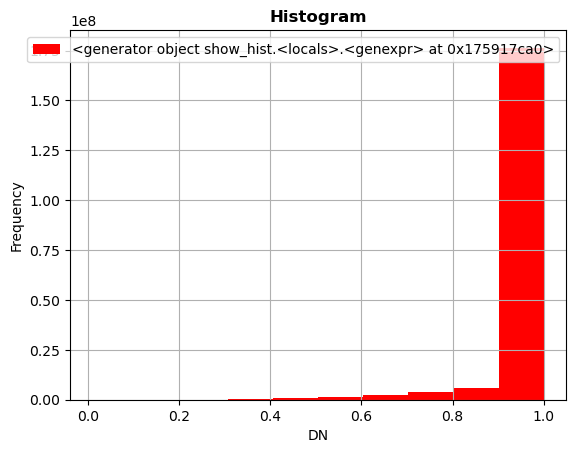

In [12]:
from rasterio.plot import show_hist
show_hist(src)

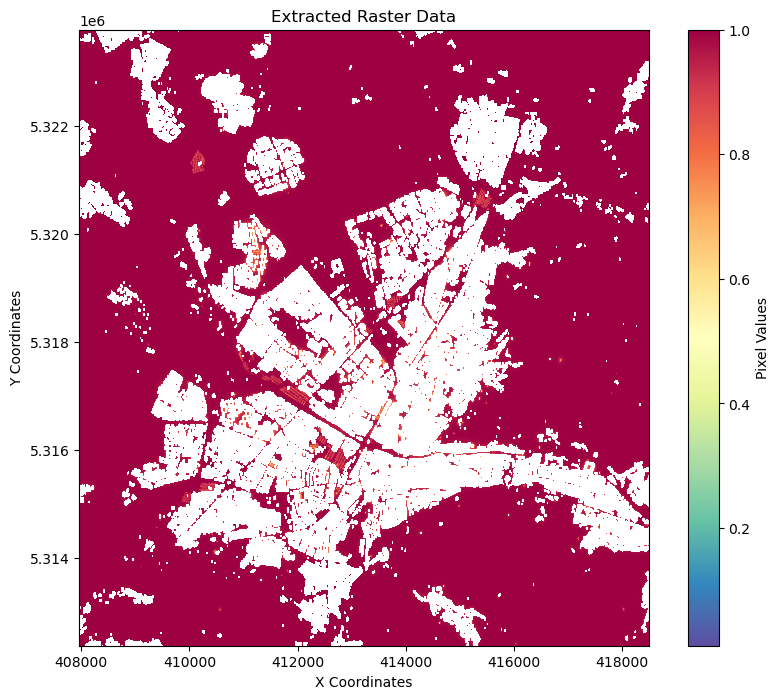

In [13]:
# Create a window from the bounding box
window = rasterio.windows.from_bounds(min_x, min_y, max_x, max_y, transform=src.transform)

# Read the data within the window
data = src.read(1, window=window)

# Get the transform for the window
window_transform = src.window_transform(window)

# Plot the extracted raster data
plt.figure(figsize=(10, 8))
plt.imshow(data, cmap='Spectral_r', extent=(min_x, max_x, min_y, max_y))
plt.colorbar(label="Pixel Values")
plt.title("Extracted Raster Data")
plt.xlabel("X Coordinates")
plt.ylabel("Y Coordinates")
plt.show()

In [14]:
# Define the bounding box coordinates
min_y, max_y = 5315973, 5316776  # X-coordinates
min_x, max_x = 413858, 414606  # Y-coordinates

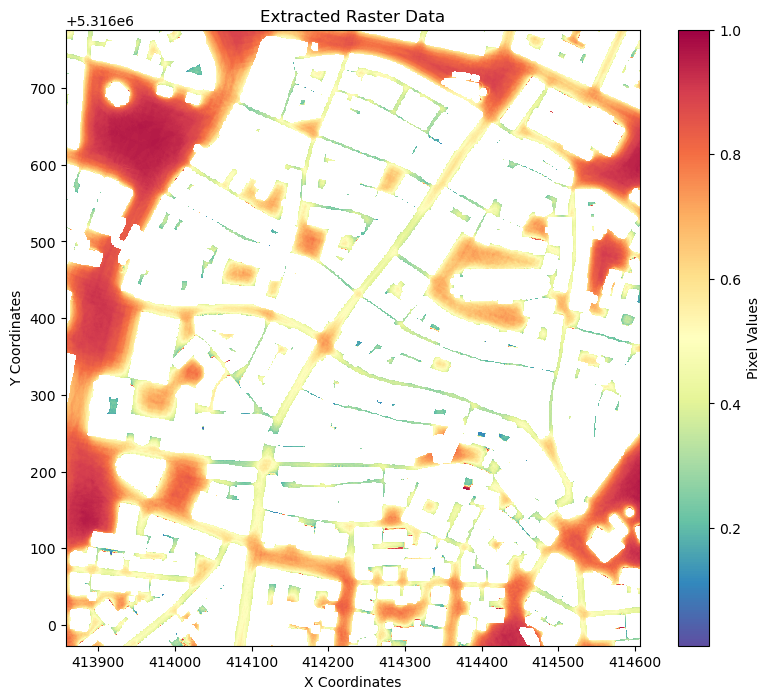

In [15]:
# Create a window from the bounding box
window = rasterio.windows.from_bounds(min_x, min_y, max_x, max_y, transform=src.transform)

# Read the data within the window
data = src.read(1, window=window)

# Get the transform for the window
window_transform = src.window_transform(window)

# Plot the extracted raster data
plt.figure(figsize=(10, 8))
plt.imshow(data, cmap='Spectral_r', extent=(min_x, max_x, min_y, max_y))
plt.colorbar(label="Pixel Values")
plt.title("Extracted Raster Data")
plt.xlabel("X Coordinates")
plt.ylabel("Y Coordinates")
plt.show()

In [16]:
src.read(1)[4184000:4195000, 5322000:5333000]

array([], shape=(0, 0), dtype=float32)

In [17]:
features_bldg = ['BuAre','BuVol_3D','BuEWA_3D','BuSWR_3D','BuHt','BuERI']
features_str = ['StrHW']
features_nodes = ['StrClo400']


In [22]:
def plot_network_chars(column,elements):

    ax = elements.plot(
        column=column,
        cmap="Spectral_r",
        scheme="quantiles",
        k=15,
        alpha=1,
        figsize=(15, 15),
    )
    #add colorbar
    sm = plt.cm.ScalarMappable(
        cmap="Spectral_r",
        norm=plt.Normalize(vmin=elements[column].min(), vmax=elements[column].max()),
    )

    sm._A = []
    cbar = plt.colorbar(sm, ax=ax, fraction=0.02, orientation="horizontal")
    cbar.set_label(column)
    
    ax.set_axis_off()
    _ = ax.set_title(column)
    plt.savefig(f'/Users/lisawink/Documents/paper1/figures/maps/fig3/{column}.svg',bbox_inches='tight')
    plt.savefig(f'/Users/lisawink/Documents/paper1/figures/maps/fig3/{column}.png',bbox_inches='tight')

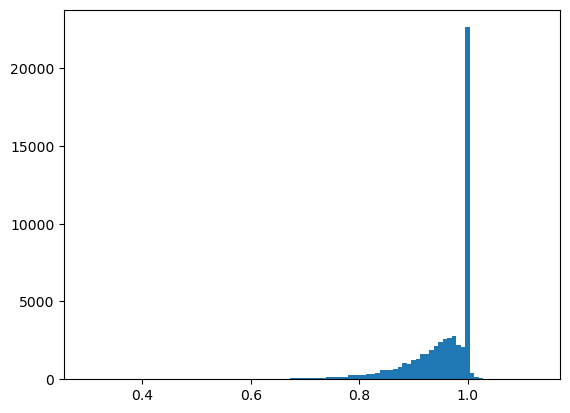

In [19]:
bldgs['BuERI'].hist(bins=100)
plt.grid(False)
plt.savefig(f'/Users/lisawink/Documents/paper1/figures/maps/fig3/BuERI_hist.svg',bbox_inches='tight')

<Axes: >

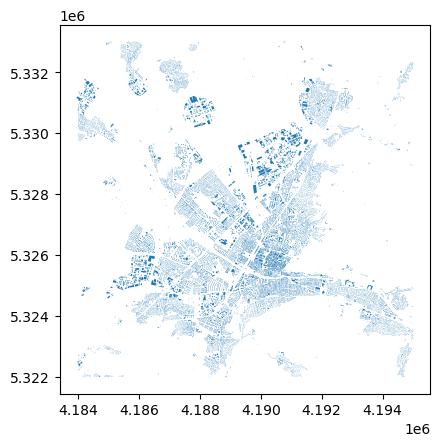

In [20]:
bldgs.cx[4184000:4195000, 5322000:5333000].plot()

/Users/lisawink/.conda/envs/py312_uscuni_buildingfootprints/lib/python3.12/site-packages/mapclassify/classifiers.py:1592: UserWarning: Not enough unique values in array to form 15 classes. Setting k to 13.
  self.bins = quantile(y, k=k)


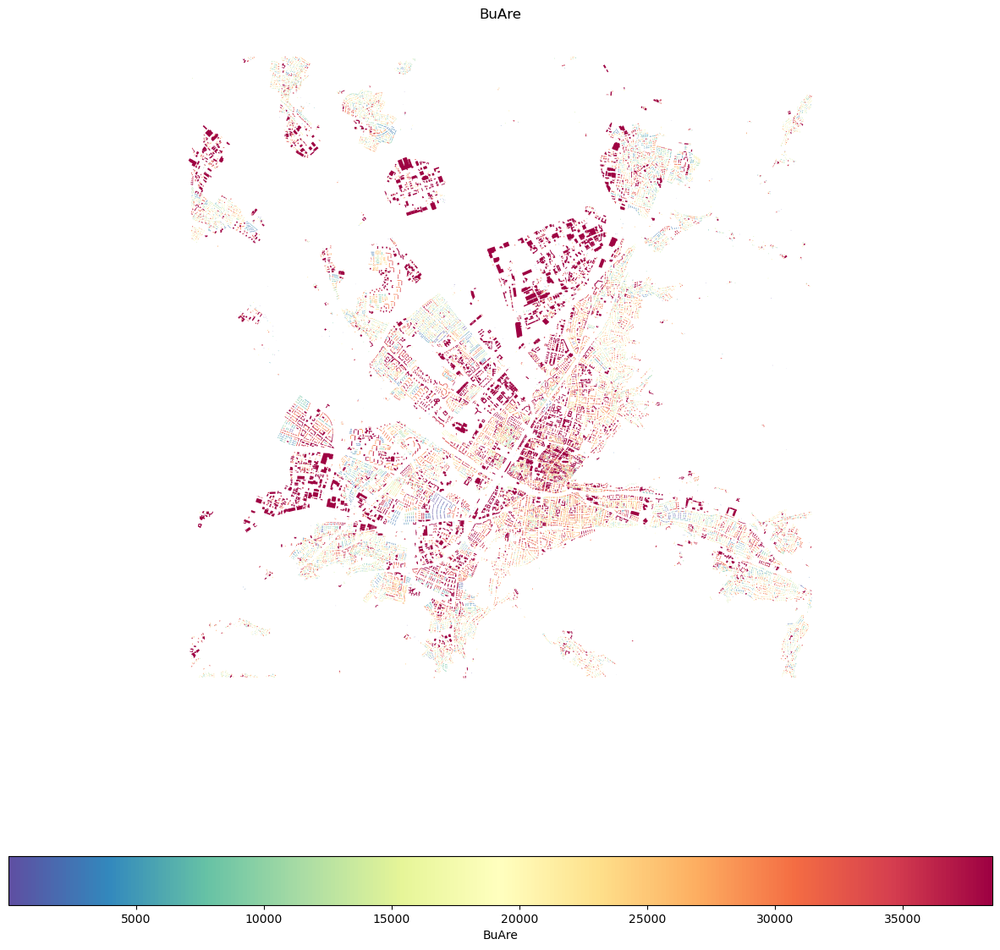

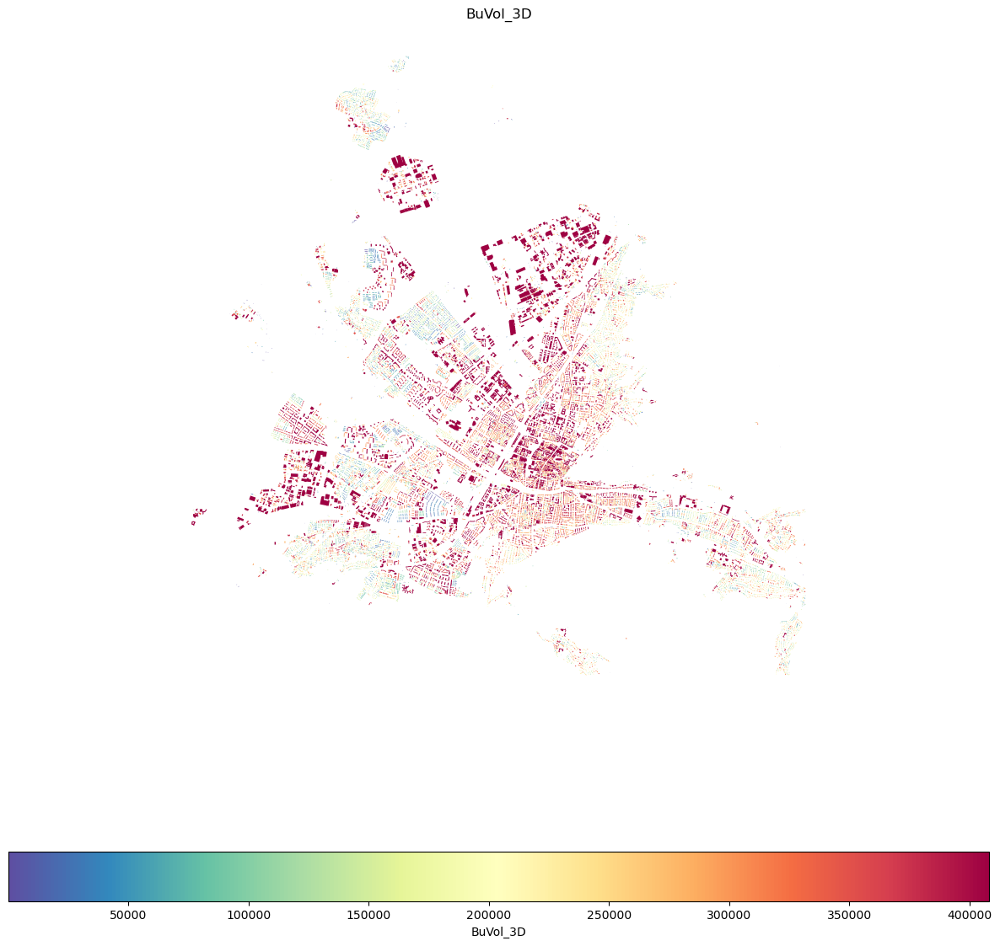

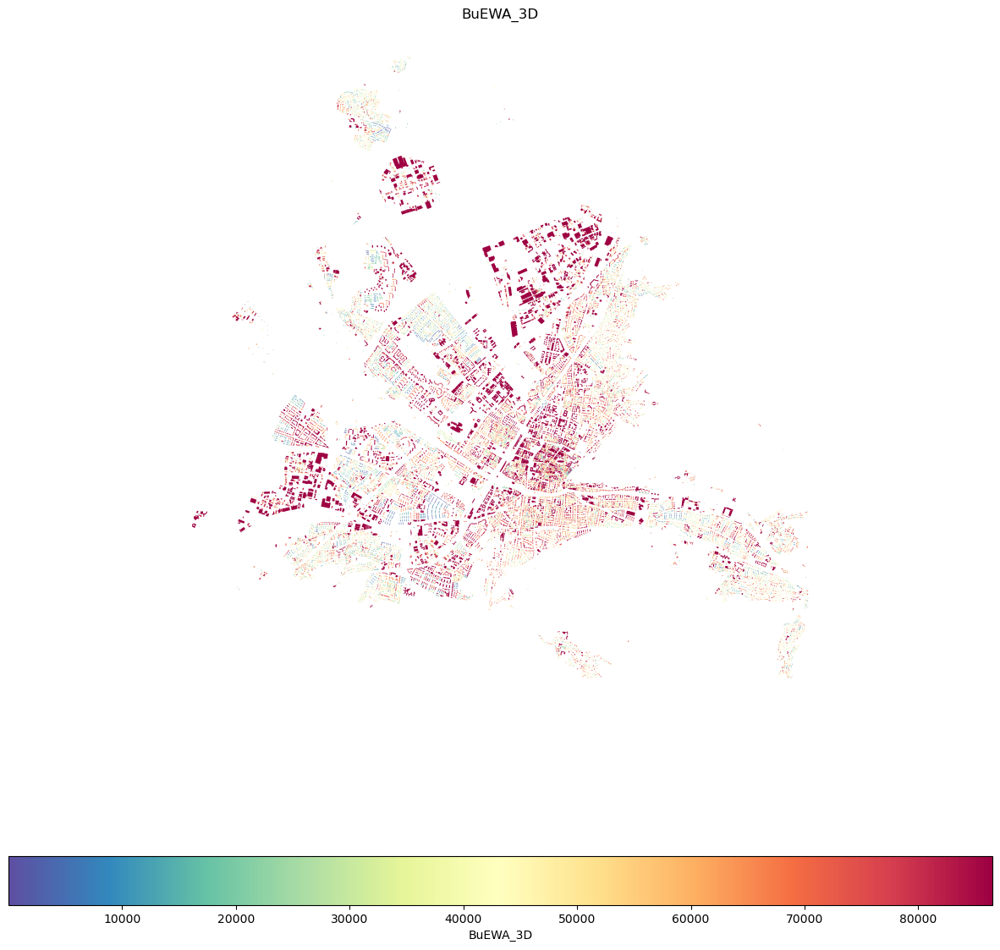

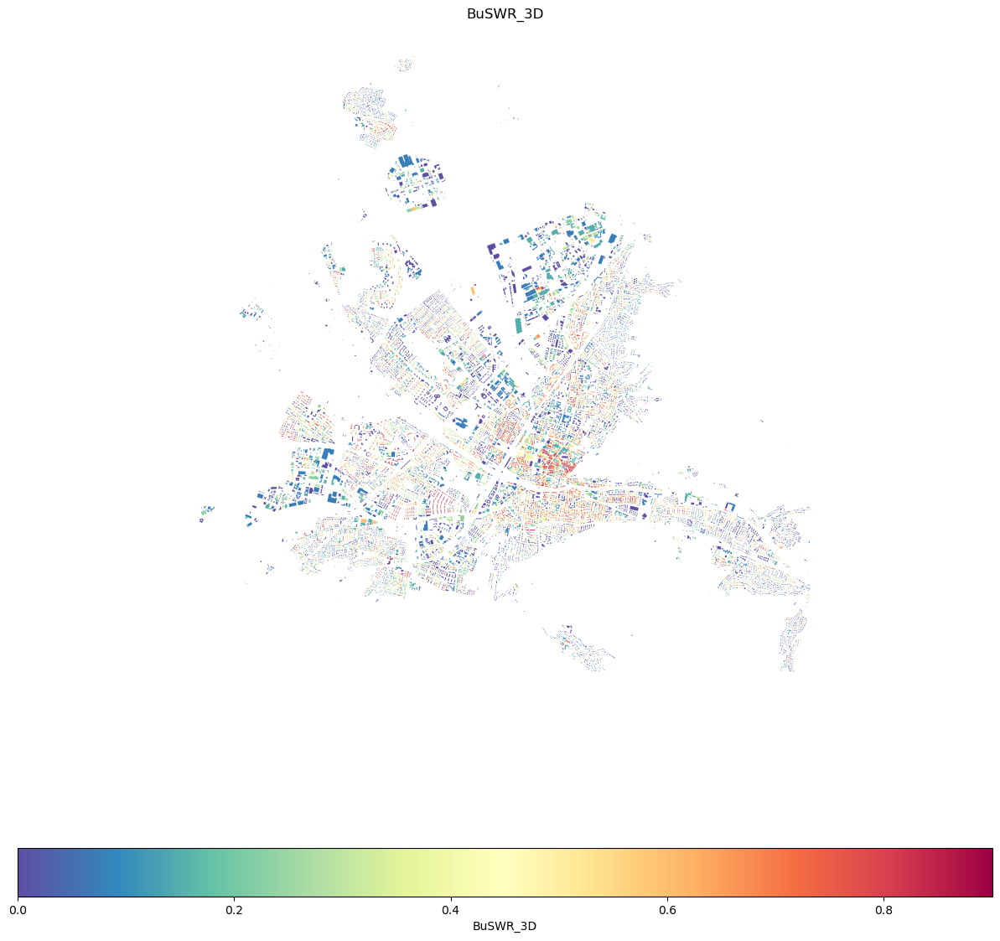

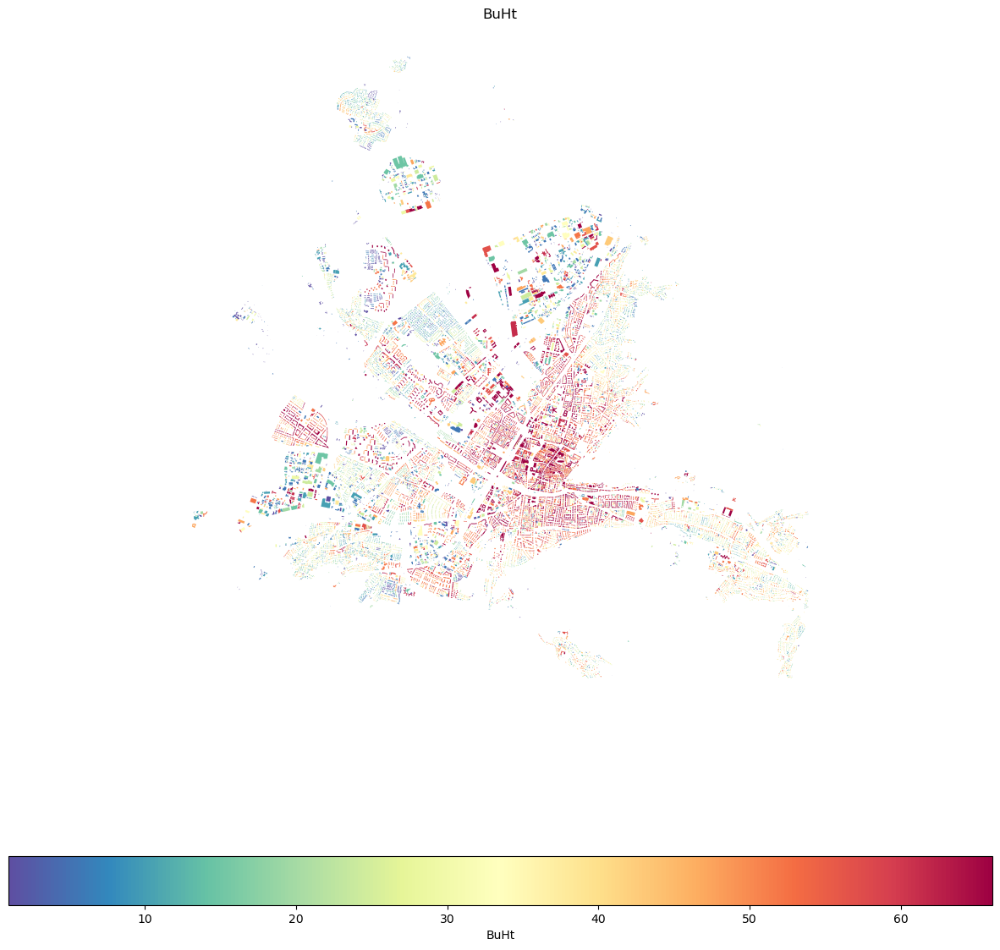

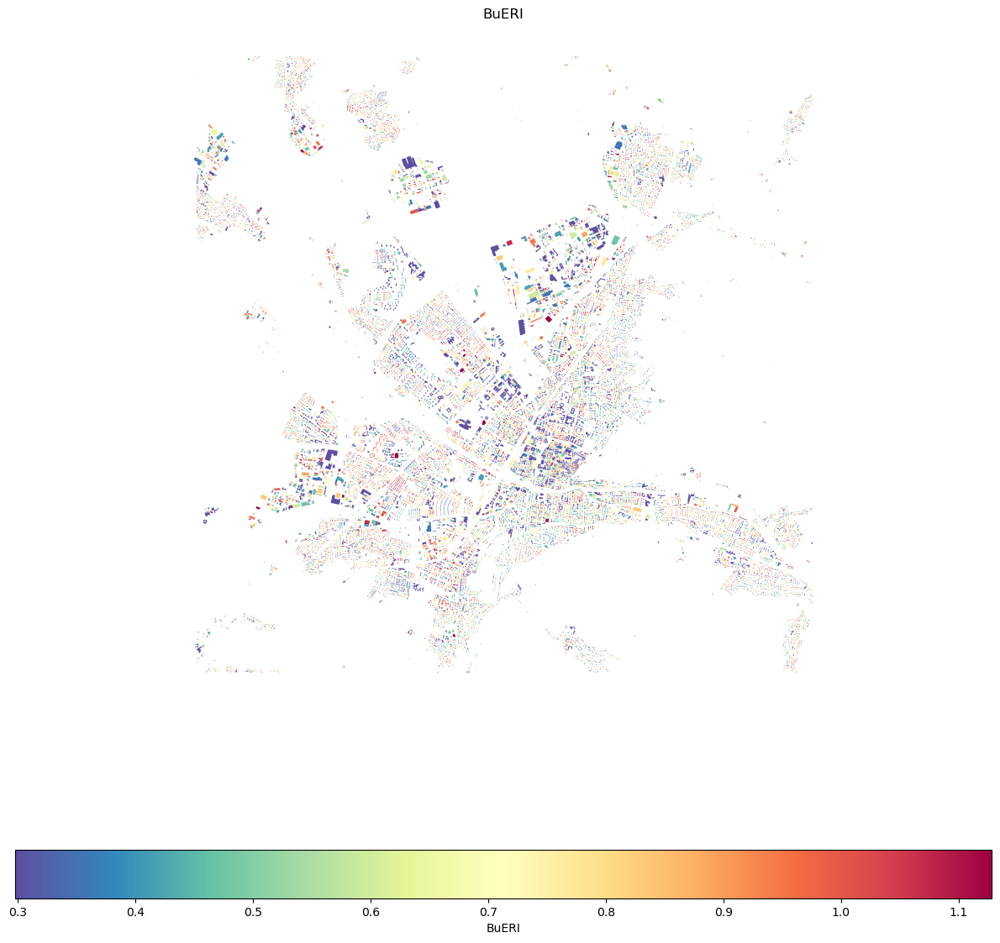

In [23]:
for i in features_bldg:
    plot_network_chars(i,bldgs.cx[4184000:4195000, 5322000:5333000])

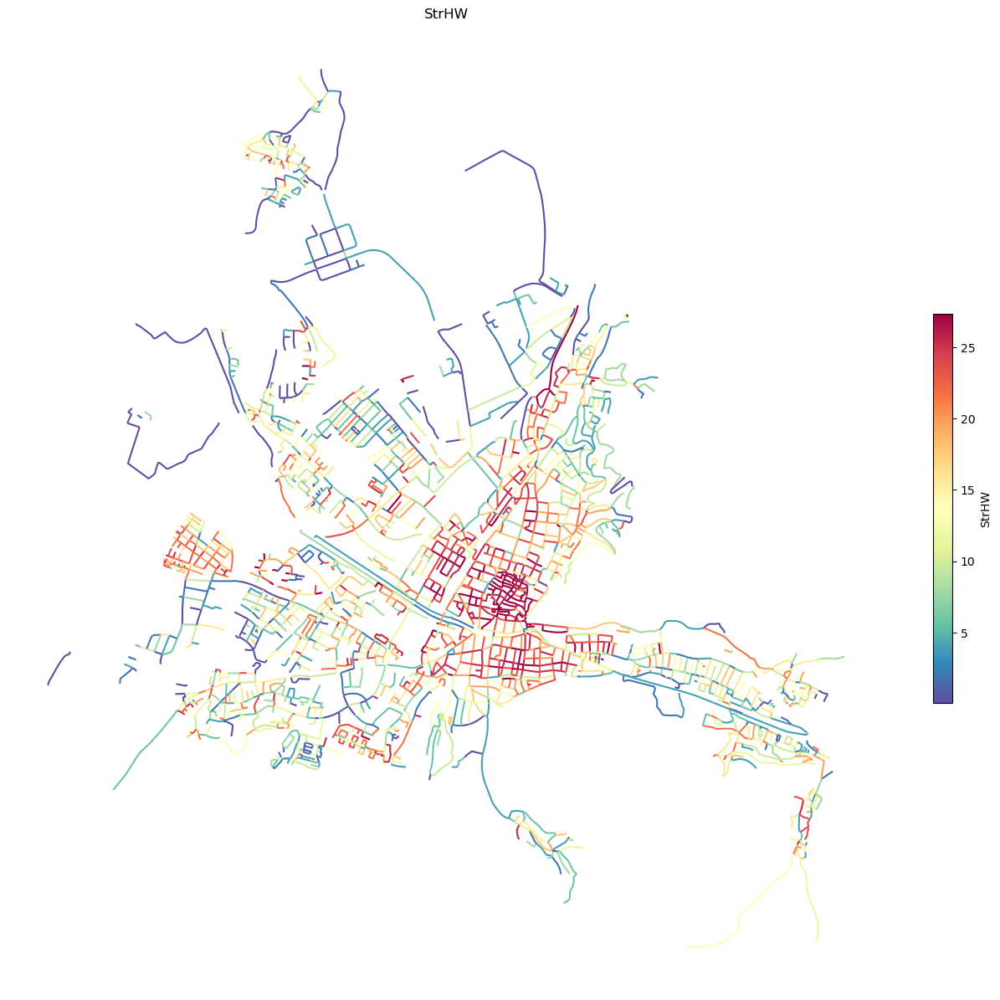

In [95]:
for i in features_str:
    plot_network_chars(i,streets.cx[4184000:4195000, 5322000:5333000])

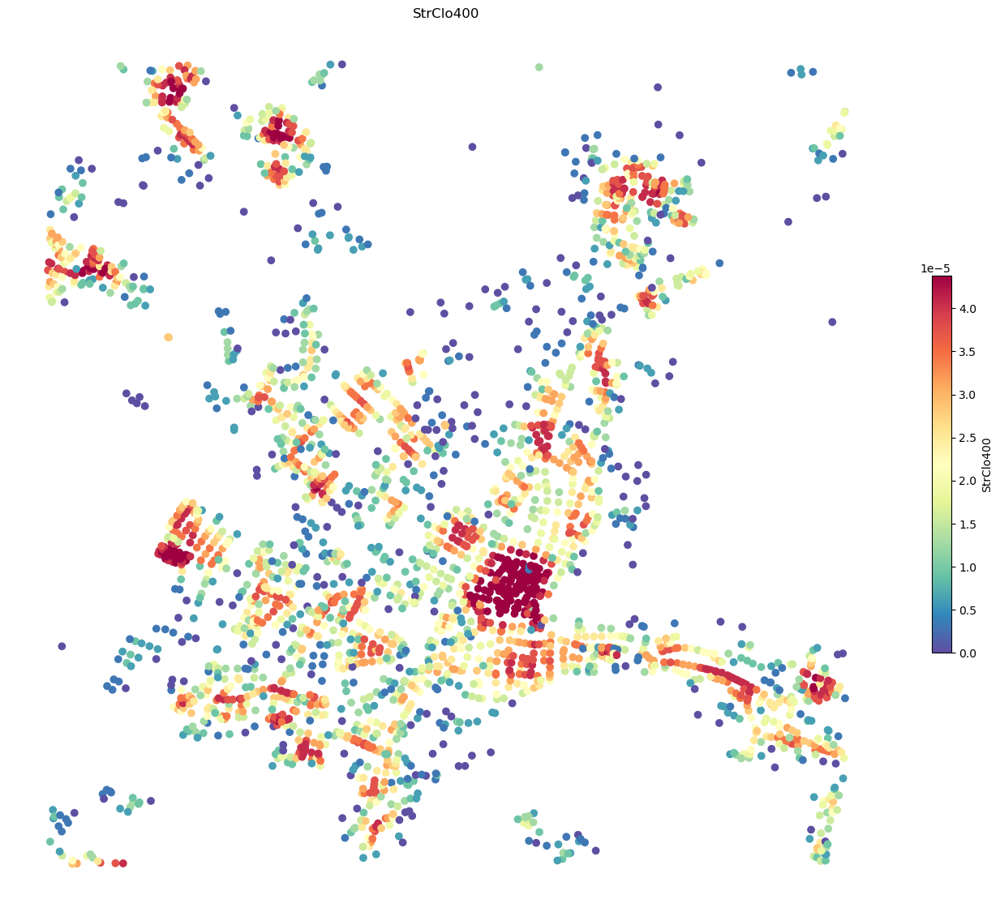

In [96]:
for i in features_nodes:
    plot_network_chars(i,nodes.cx[4184000:4195000, 5322000:5333000])

In [4]:
features = bldgs.columns.values.flatten()

In [5]:
features

array(['oid', 'aktualit', 'gebnutzbez', 'funktion', 'fktkurz', 'name_2d',
       'anzahlgs', 'lagebeztxt', 'geometry_2d', 'type_2D', 'attributes',
       'geometry_3d', 'Bodenhoehe', 'Firsthoehe', 'Traufhoehe',
       'measuredHeight', 'roofType', 'Gemeindeschluessel', 'Hausnummer',
       'Lagebezeichnung', 'class', 'name_3d', '0', 'street_index',
       'BuAre', 'BuHt', 'BuPer', 'BuLAL', 'BuCCD_mean', 'BuCCD_std',
       'BuCor', 'CyAre', 'CyInd', 'BuCCo', 'BuCWA', 'BuCon', 'BuElo',
       'BuERI', 'BuFR', 'BuFF', 'BuFD', 'BuRec', 'BuShI', 'BuSqC',
       'BuCorDev', 'BuSW', 'BuSWR', 'BuOri', 'BuAli', 'StrAli', 'id',
       'type_3D', 'lod', 'point_count', 'unique_point_count', 'BuSurf_3D',
       'BuVol_3D', 'convex_hull_volume', 'obb_volume', 'aabb_volume',
       'footprint_perimeter', 'obb_width', 'obb_length', 'BuSA_3D',
       'ground_area', 'wall_area', 'roof_area', 'ground_point_count',
       'wall_point_count', 'roof_point_count', 'ground_surface-count',
       'wall_surfac

In [ ]:
features_bldg = ['BuAre','BuVol','BuEWA','BuSWR','BuHt']
features_str = ['StrHW']


In [32]:
features = ['BuAre', 'BuHt', 'BuPer', 'BuLAL', 'BuCCD_mean', 'BuCCD_std',
       'BuCor', 'CyAre', 'CyInd', 'BuCCo', 'BuCWA', 'BuCon', 'BuElo',
       'BuERI', 'BuFR', 'BuFF', 'BuFD', 'BuRec', 'BuShI', 'BuSqC',
       'BuCorDev', 'BuSW', 'BuSWR', 'BuOri', 'BuAli', 'StrAli', 'BuSurf_3D',
       'BuVol_3D', 'BuSA_3D',
       'BuCir', 'BuHem_3D', 
       'BuCon_3D', 'BuFra', 'BuFra_3D', 'BuCubo_3D',
       'BuSqu', 'BuCube_3D', 'BumVE_3D',
       'BuMVE_3D', 'BuFF_3D',
       'BuEPI_3D', 'BuProx', 'BuProx_3D', 'BuEx', 'BuEx_3D', 'BuSpi',
       'BuSpi_3D', 'BuPerC', 'BuCf_3D', 'BuDep', 'BuDep_3D', 'BuGir',
       'BuGir_3D', 'BuDisp', 'BuDisp_3D', 'BuRan', 'BuRan_3D', 'BuRough',
       'BuRough_3D', 'BuSWA_3D', 'BuSWR_3D',
       'BuEWA_3D', 'BuEWR_3D']

In [21]:
def plot_network_chars(column,elements):

    ax = elements.plot(
        column=column,
        cmap="Spectral_r",
        scheme="quantiles",
        k=15,
        alpha=0.6,
        figsize=(15, 15),
    )
    #add colorbar
    sm = plt.cm.ScalarMappable(
        cmap="Spectral_r",
        norm=plt.Normalize(vmin=elements[column].min(), vmax=elements[column].max()),
    )

    sm._A = []
    cbar = plt.colorbar(sm, ax=ax, fraction=0.02)
    cbar.set_label(column)
    
    ax.set_axis_off()
    _ = ax.set_title(column)
    plt.savefig(f'/Users/lisawink/Documents/paper1/figures/maps/{column}.png',bbox_inches='tight')

In [14]:
def plot_network_chars(column):

    ax = nodes.plot(
        column=column,
        cmap="Spectral_r",
        scheme="quantiles",
        k=15,
        alpha=0.6,
        figsize=(15, 15),
    )
    #add colorbar
    sm = plt.cm.ScalarMappable(
        cmap="Spectral_r",
        norm=plt.Normalize(vmin=nodes[column].min(), vmax=nodes[column].max()),
    )

    sm._A = []
    cbar = plt.colorbar(sm, ax=ax, fraction=0.02)
    cbar.set_label(column)
    
    ax.set_axis_off()
    _ = ax.set_title(column)
    plt.savefig(f'/Users/lisawink/Documents/paper1/figures/maps/{column}.png',bbox_inches='tight')

/Users/lisawink/.conda/envs/py312_uscuni_buildingfootprints/lib/python3.12/site-packages/mapclassify/classifiers.py:1592: UserWarning: Not enough unique values in array to form 15 classes. Setting k to 7.
  self.bins = quantile(y, k=k)
/Users/lisawink/.conda/envs/py312_uscuni_buildingfootprints/lib/python3.12/site-packages/mapclassify/classifiers.py:1592: UserWarning: Not enough unique values in array to form 15 classes. Setting k to 2.
  self.bins = quantile(y, k=k)
/Users/lisawink/.conda/envs/py312_uscuni_buildingfootprints/lib/python3.12/site-packages/mapclassify/classifiers.py:1592: UserWarning: Not enough unique values in array to form 15 classes. Setting k to 2.
  self.bins = quantile(y, k=k)
/Users/lisawink/.conda/envs/py312_uscuni_buildingfootprints/lib/python3.12/site-packages/mapclassify/classifiers.py:1592: UserWarning: Not enough unique values in array to form 15 classes. Setting k to 13.
  self.bins = quantile(y, k=k)
/Users/lisawink/.conda/envs/py312_uscuni_buildingfootpr

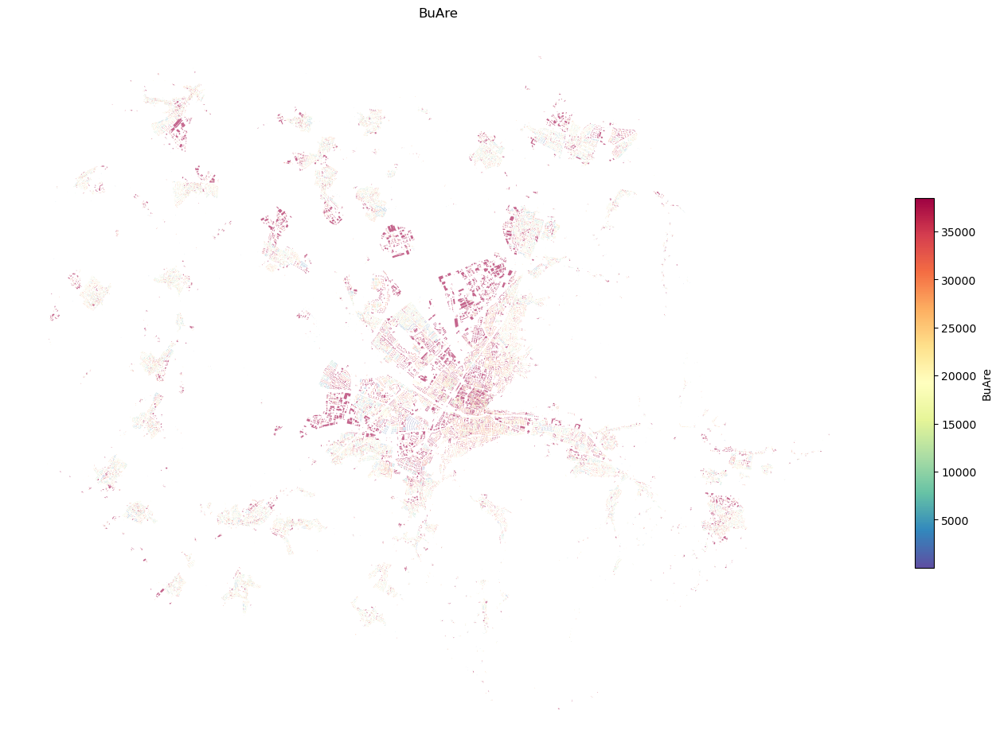

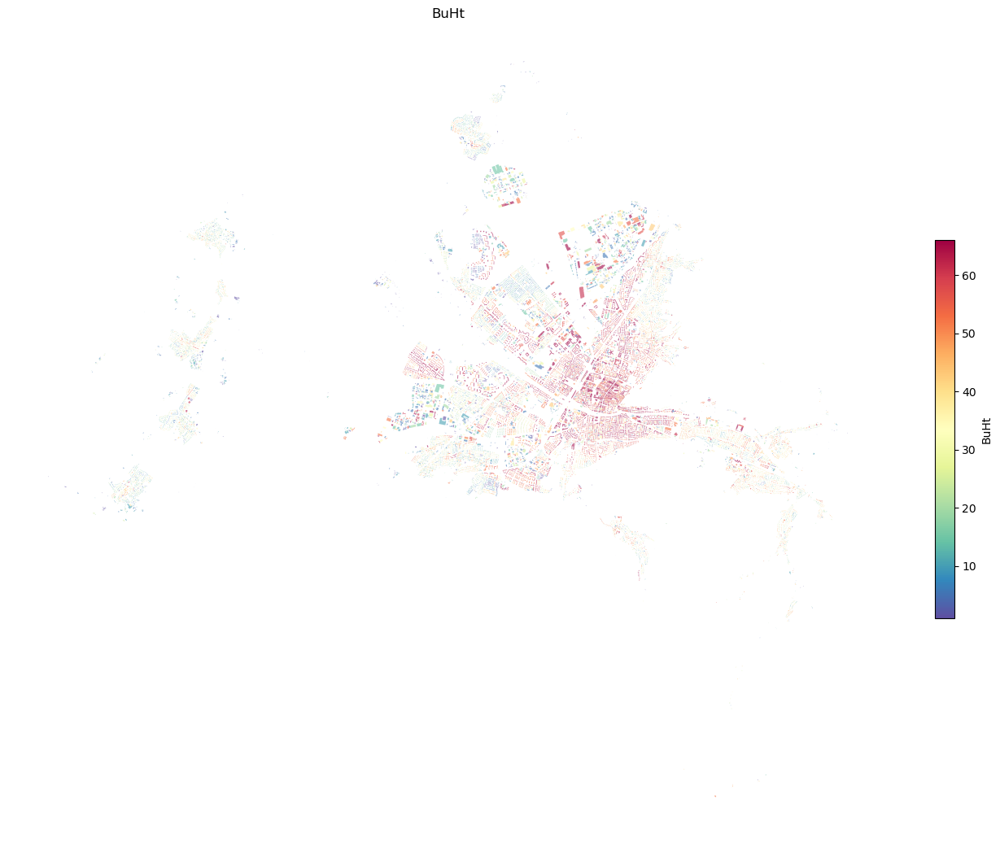

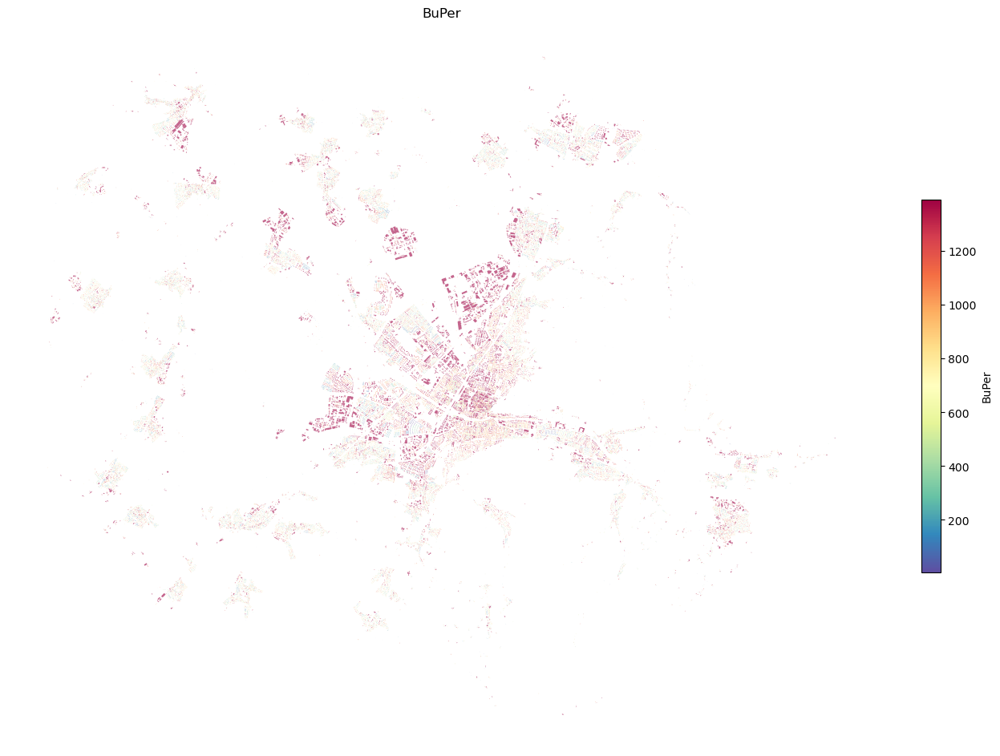

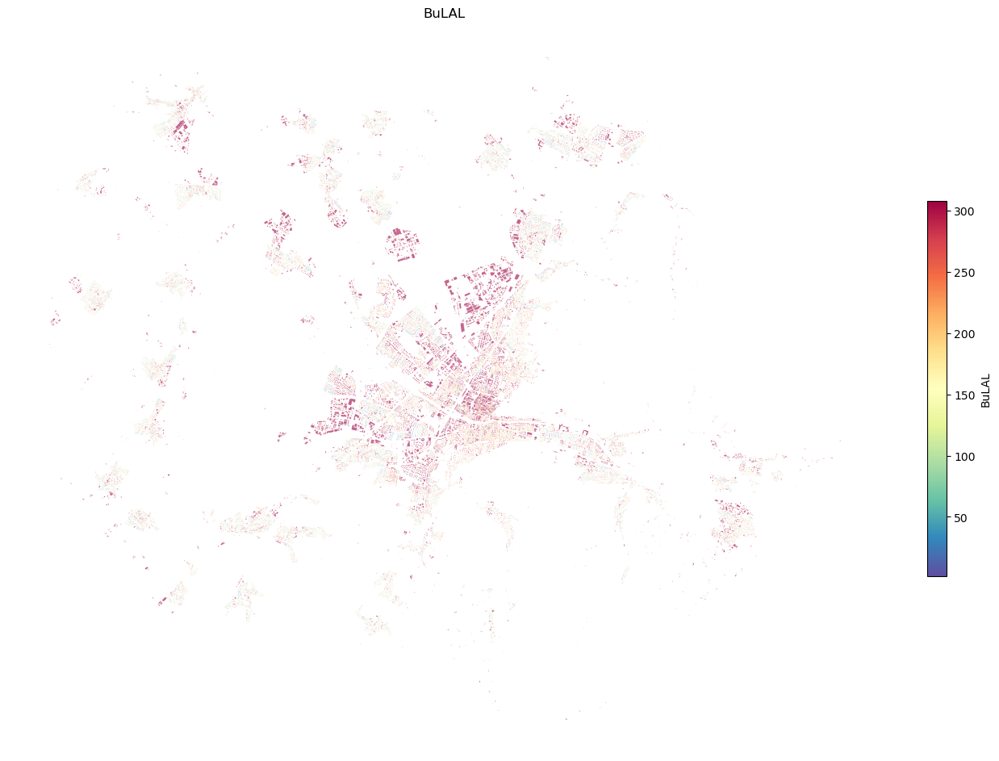

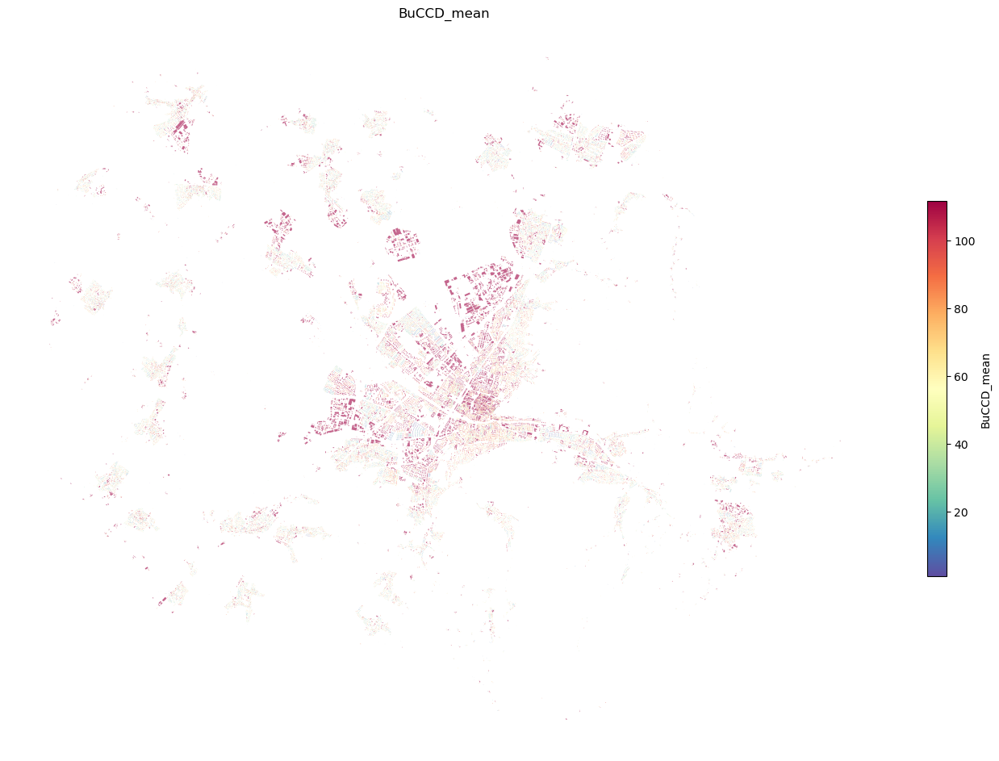

...

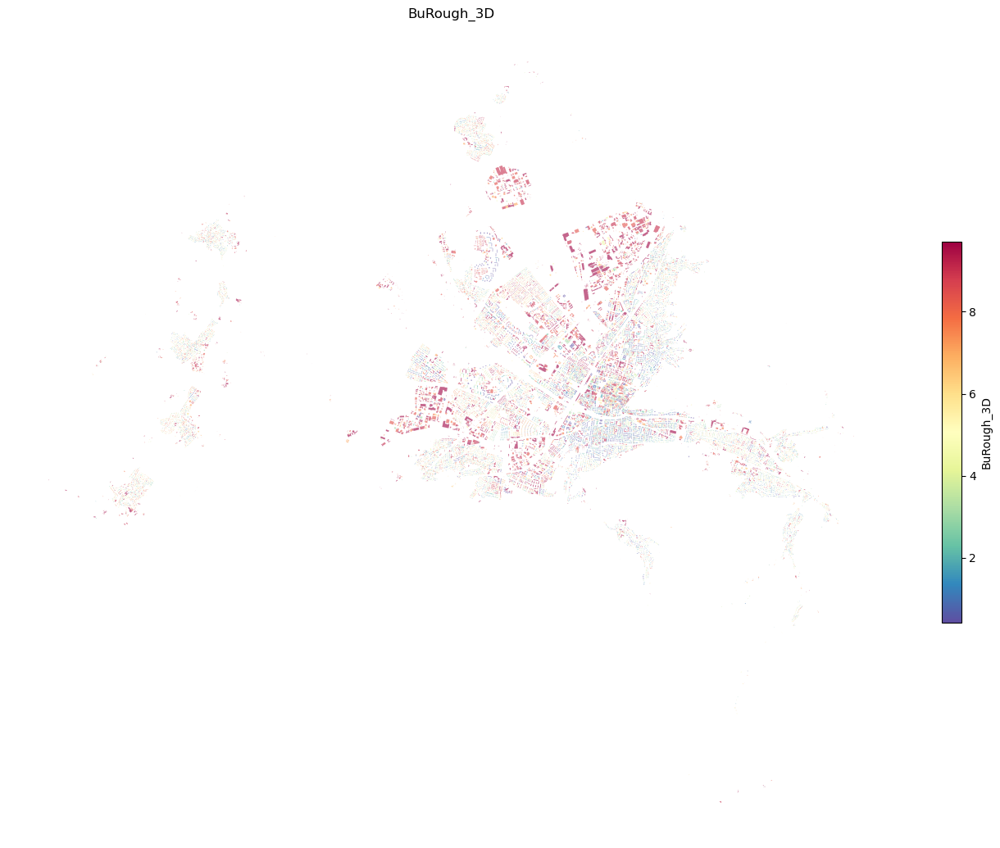

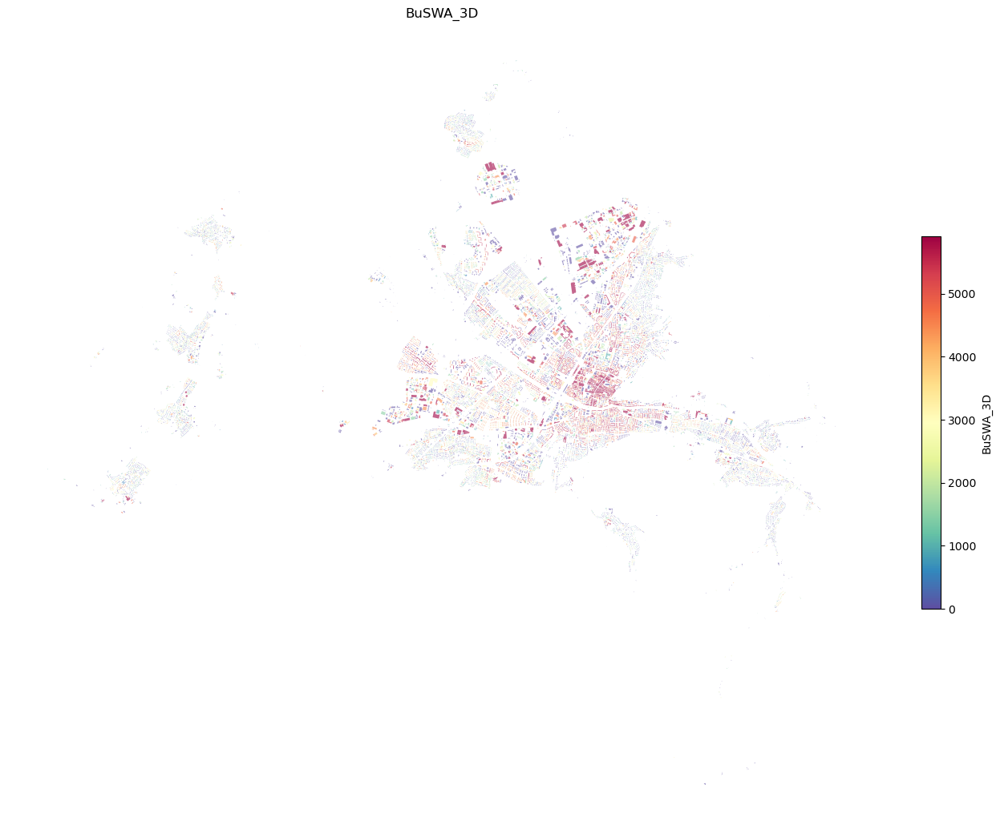

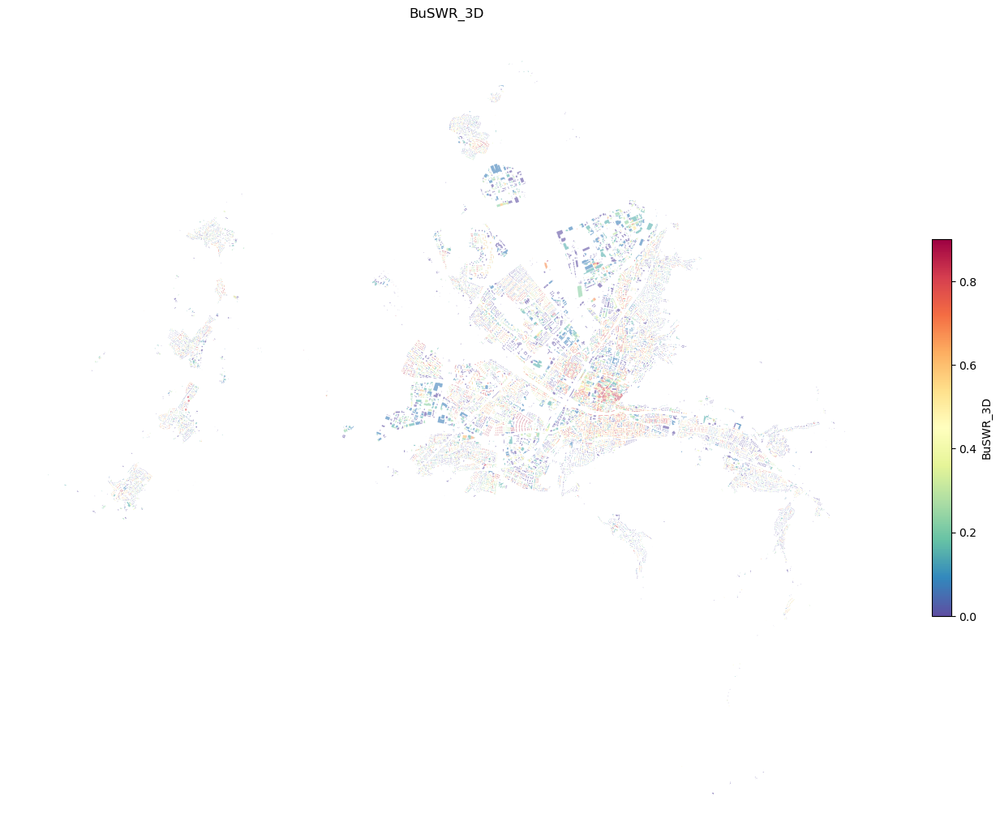

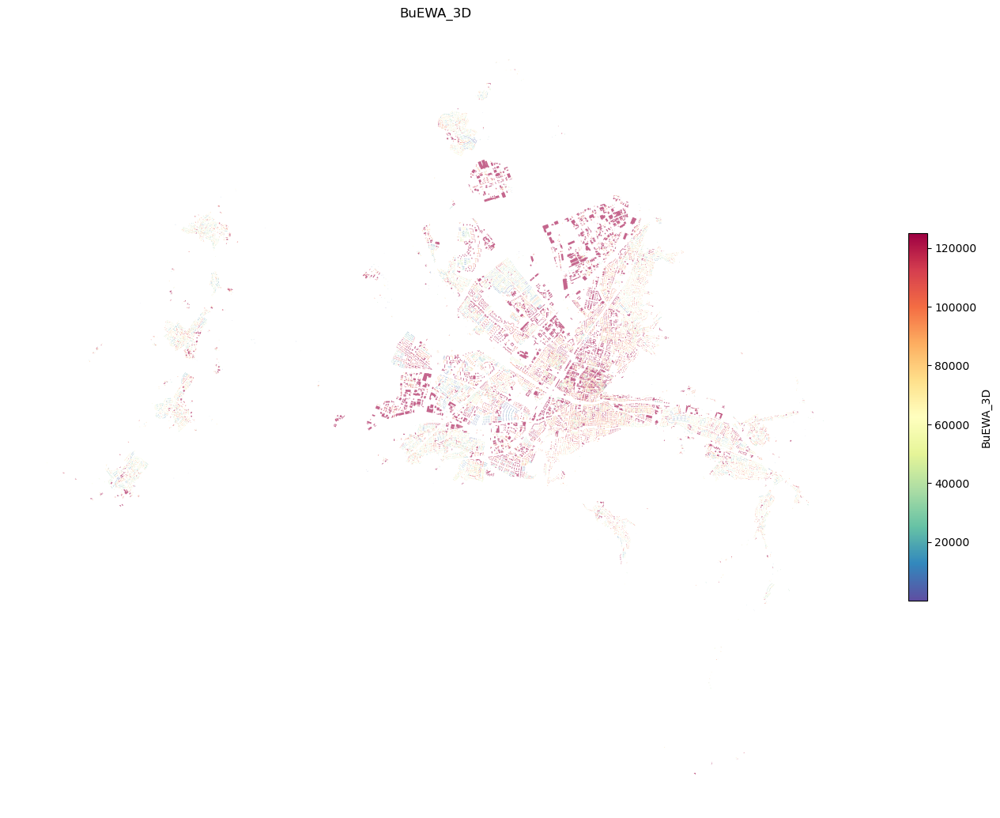

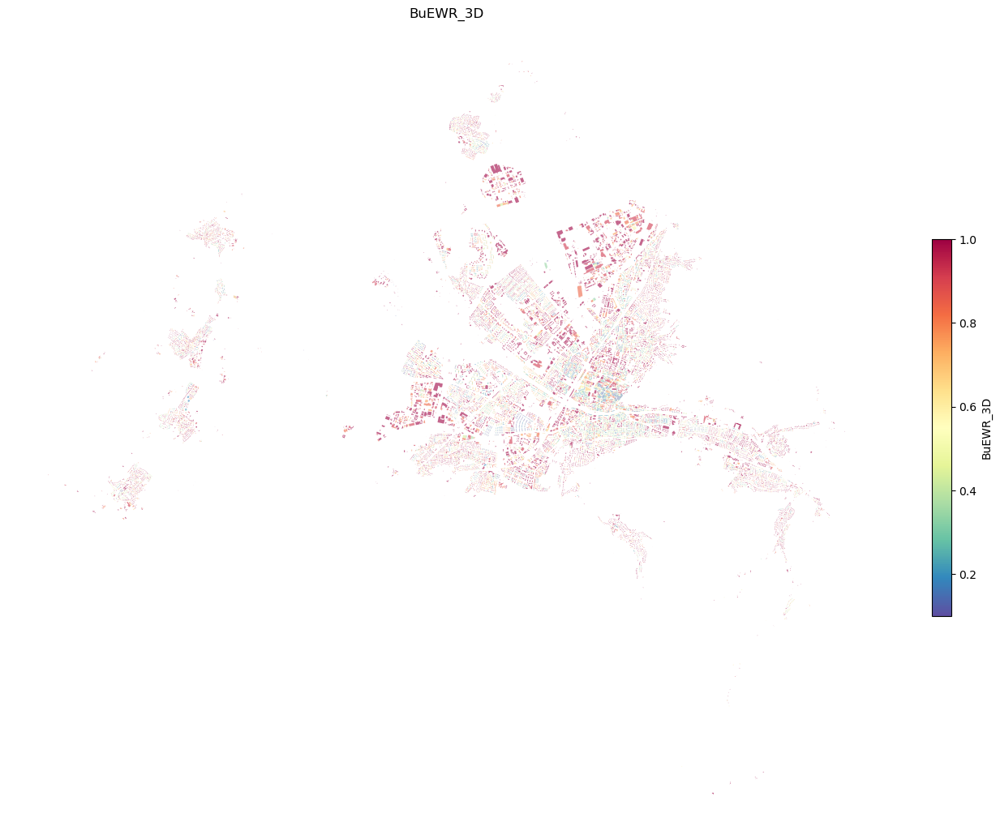

In [33]:
for i in features:
    plot_network_chars(i,bldgs)

/Users/lisawink/.conda/envs/py312_uscuni_buildingfootprints/lib/python3.12/site-packages/mapclassify/classifiers.py:1592: UserWarning: Not enough unique values in array to form 15 classes. Setting k to 11.
  self.bins = quantile(y, k=k)
/Users/lisawink/.conda/envs/py312_uscuni_buildingfootprints/lib/python3.12/site-packages/mapclassify/classifiers.py:1592: UserWarning: Not enough unique values in array to form 15 classes. Setting k to 11.
  self.bins = quantile(y, k=k)
/Users/lisawink/.conda/envs/py312_uscuni_buildingfootprints/lib/python3.12/site-packages/mapclassify/classifiers.py:1592: UserWarning: Not enough unique values in array to form 15 classes. Setting k to 12.
  self.bins = quantile(y, k=k)


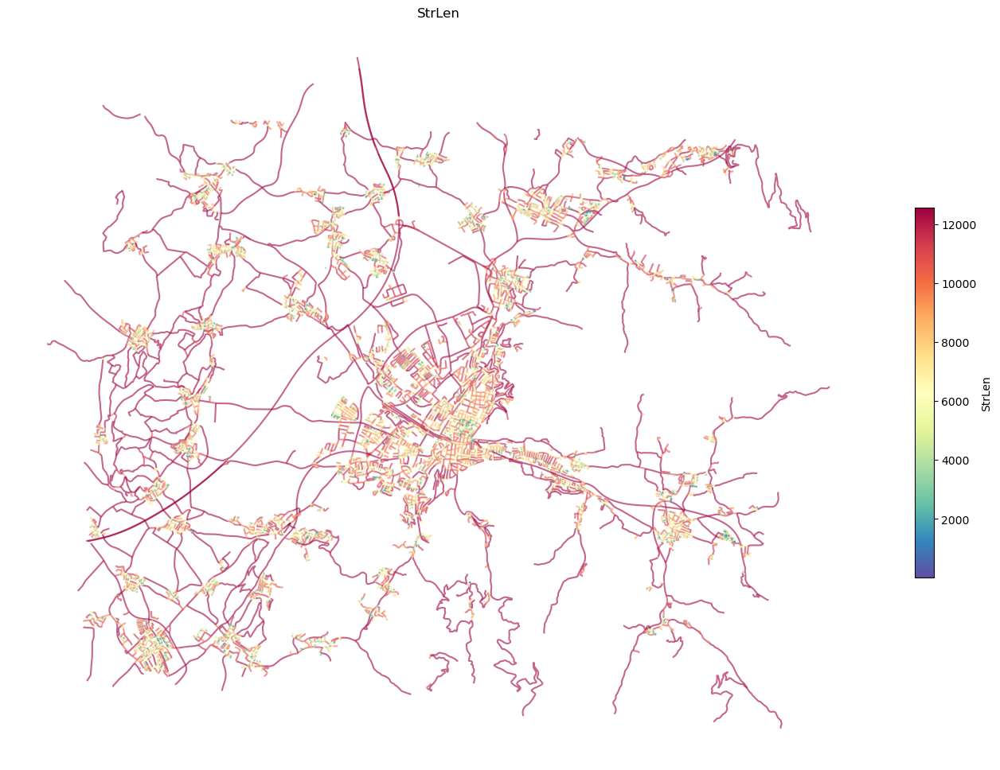

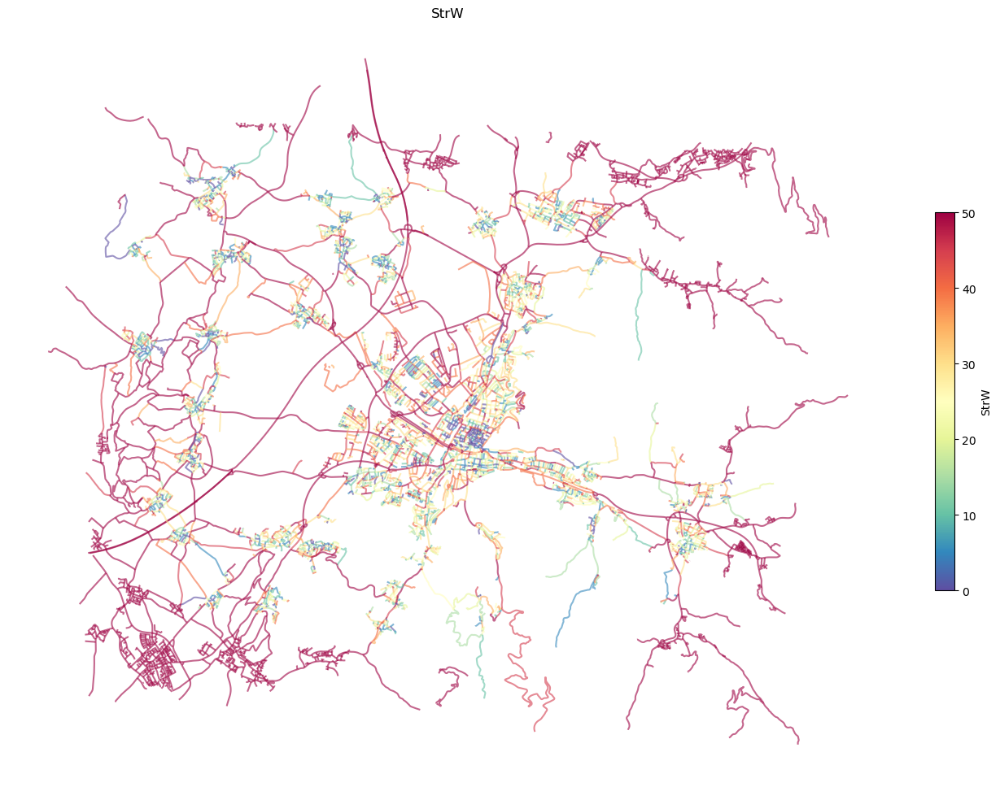

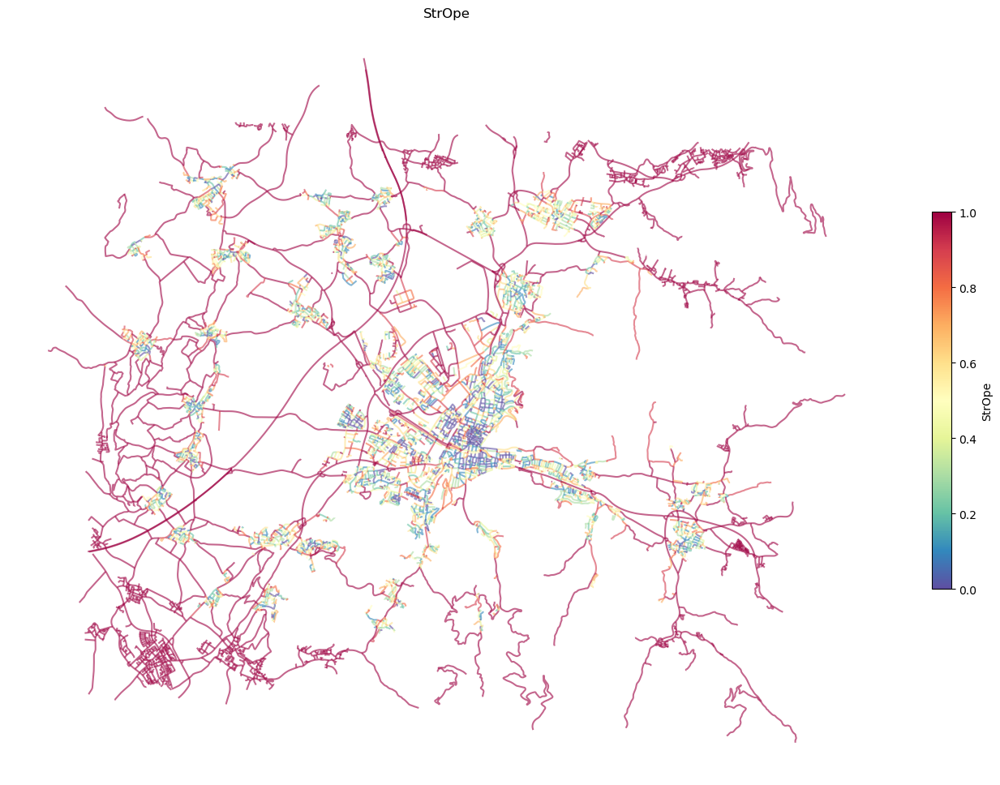

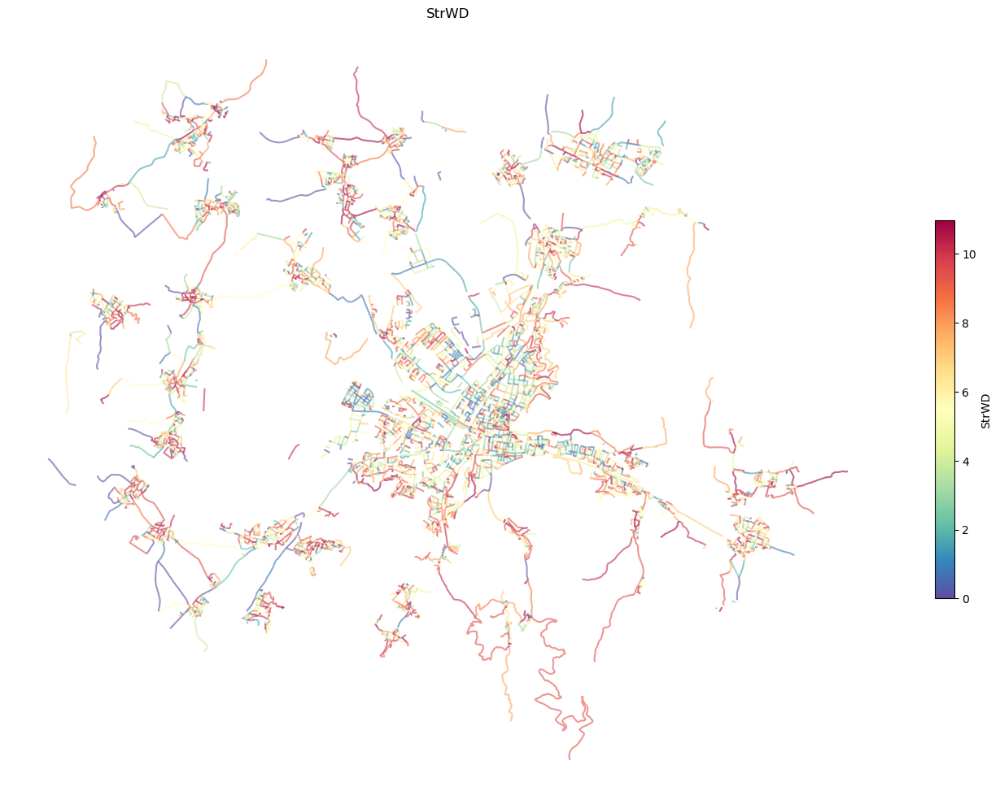

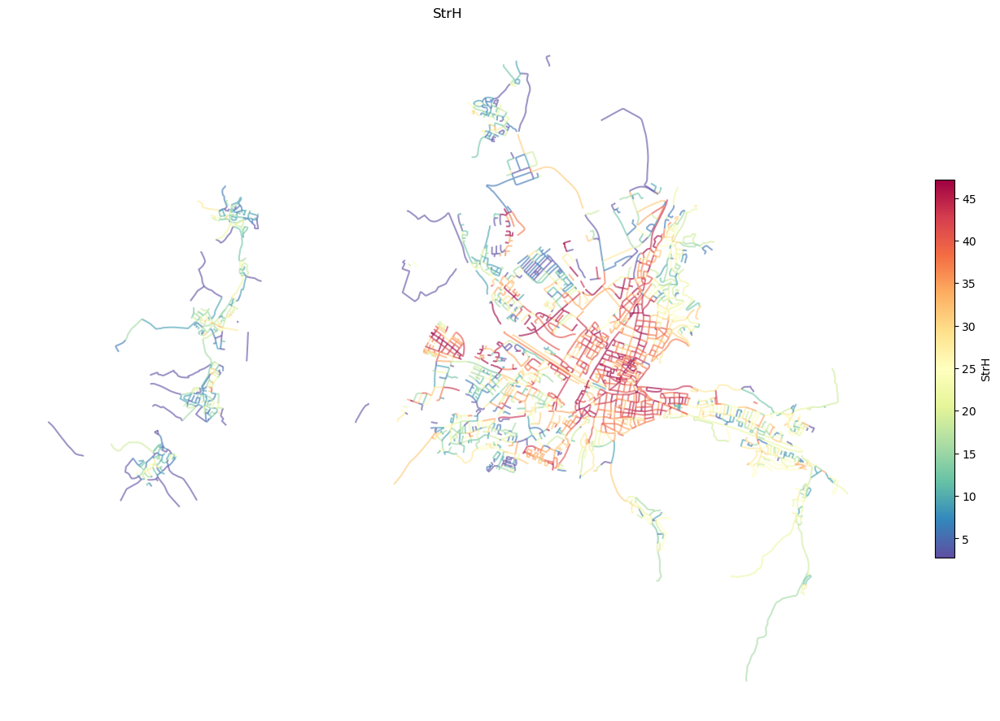

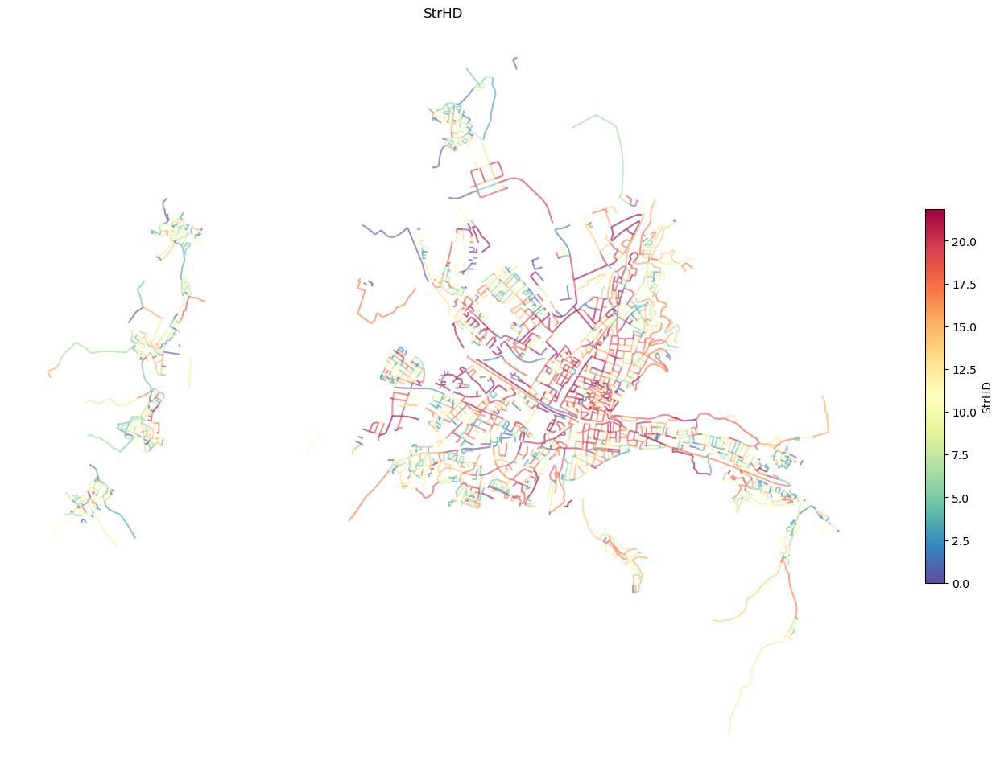

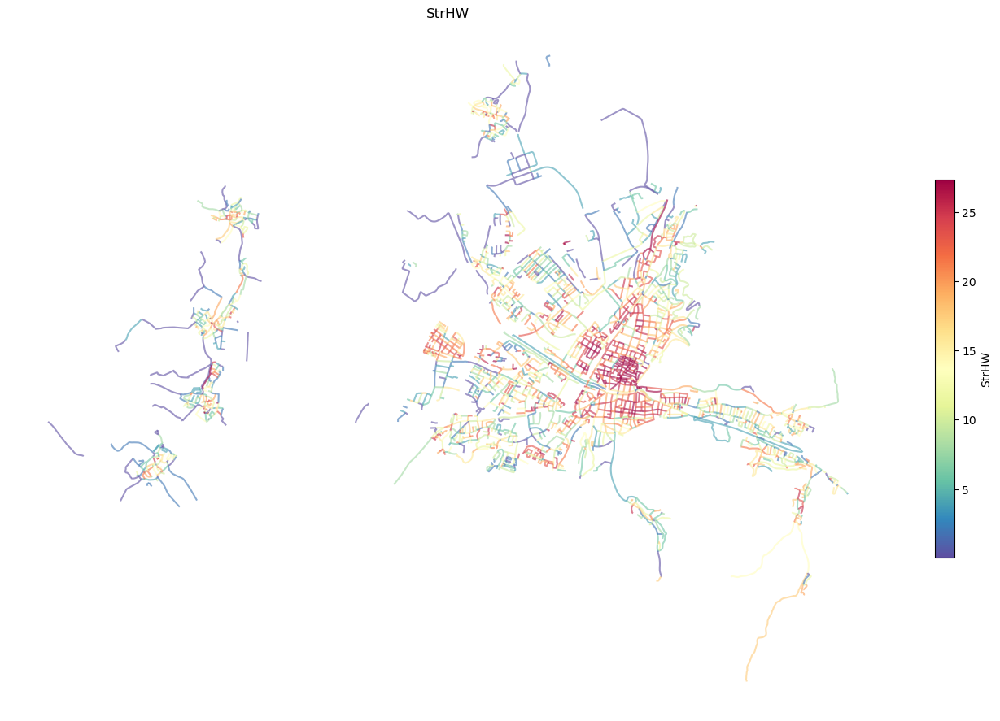

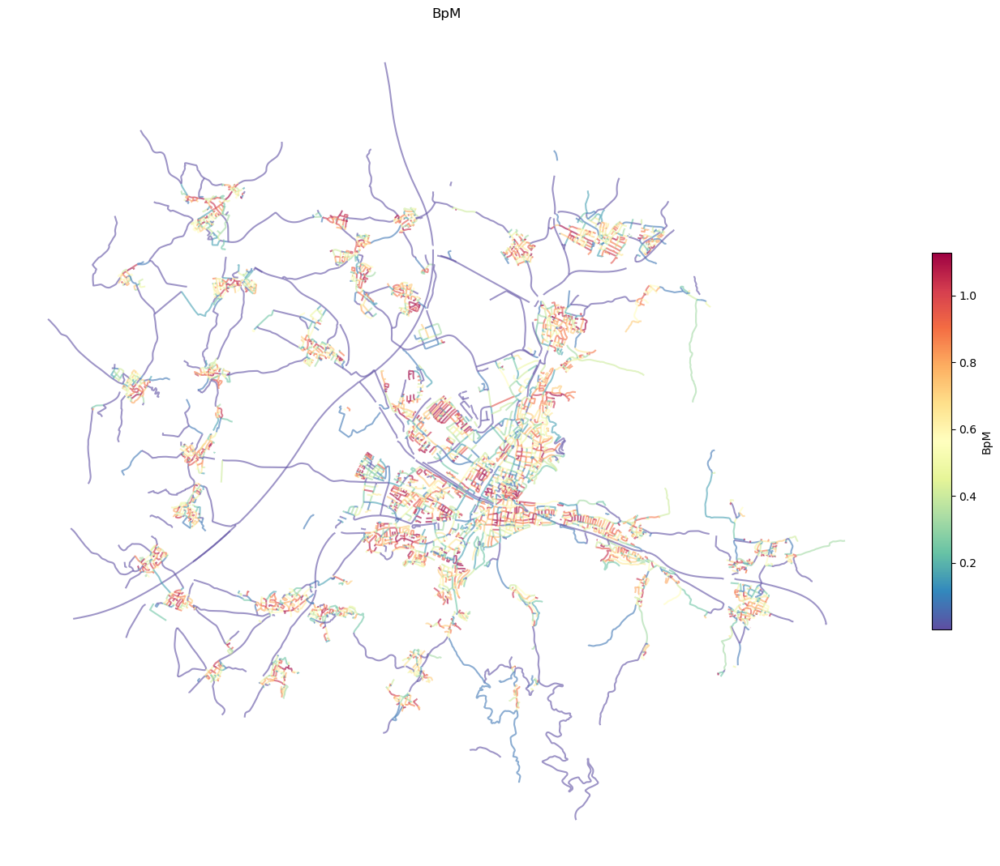

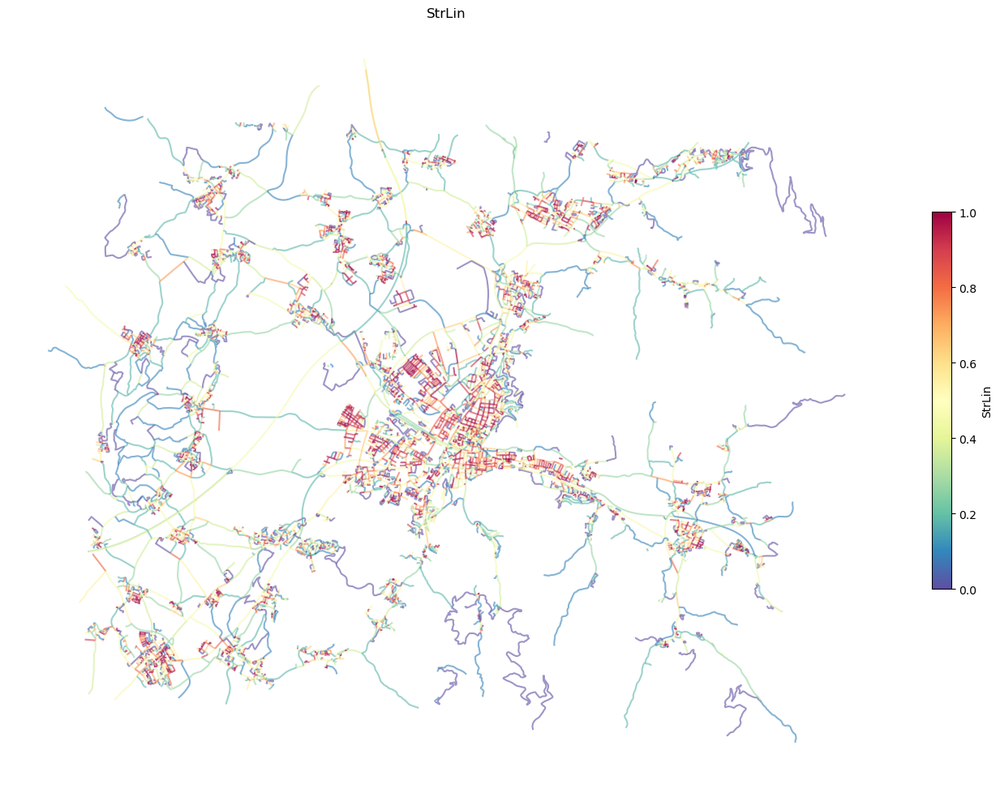

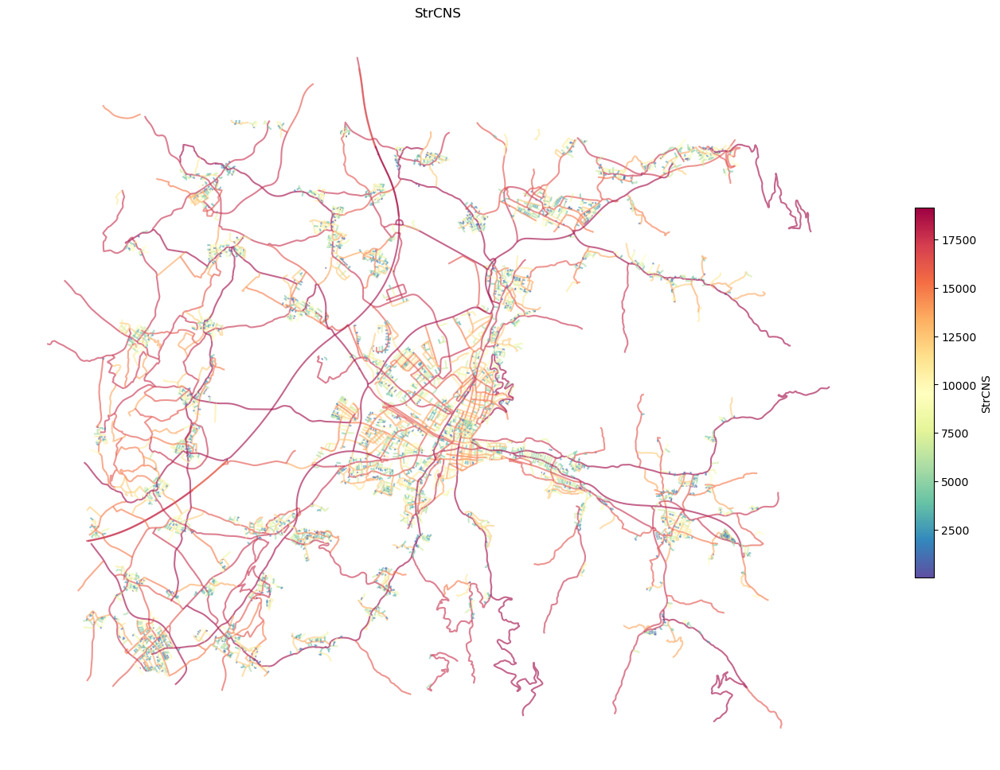

In [23]:
for i in ['StrLen','StrW','StrOpe','StrWD','StrH','StrHD','StrHW','BpM','StrLin','StrCNS']:
    plot_network_chars(i,streets)

In [3]:
nodes=gpd.read_parquet('/Users/lisawink/Documents/paper1/data/processed_data/processed_nodes.parquet')

/Users/lisawink/.conda/envs/py312_uscuni_buildingfootprints/lib/python3.12/site-packages/mapclassify/classifiers.py:1592: UserWarning: Not enough unique values in array to form 15 classes. Setting k to 11.
  self.bins = quantile(y, k=k)
/Users/lisawink/.conda/envs/py312_uscuni_buildingfootprints/lib/python3.12/site-packages/mapclassify/classifiers.py:1592: UserWarning: Not enough unique values in array to form 15 classes. Setting k to 12.
  self.bins = quantile(y, k=k)
/Users/lisawink/.conda/envs/py312_uscuni_buildingfootprints/lib/python3.12/site-packages/mapclassify/classifiers.py:1592: UserWarning: Not enough unique values in array to form 15 classes. Setting k to 9.
  self.bins = quantile(y, k=k)
/Users/lisawink/.conda/envs/py312_uscuni_buildingfootprints/lib/python3.12/site-packages/mapclassify/classifiers.py:1592: UserWarning: Not enough unique values in array to form 15 classes. Setting k to 14.
  self.bins = quantile(y, k=k)


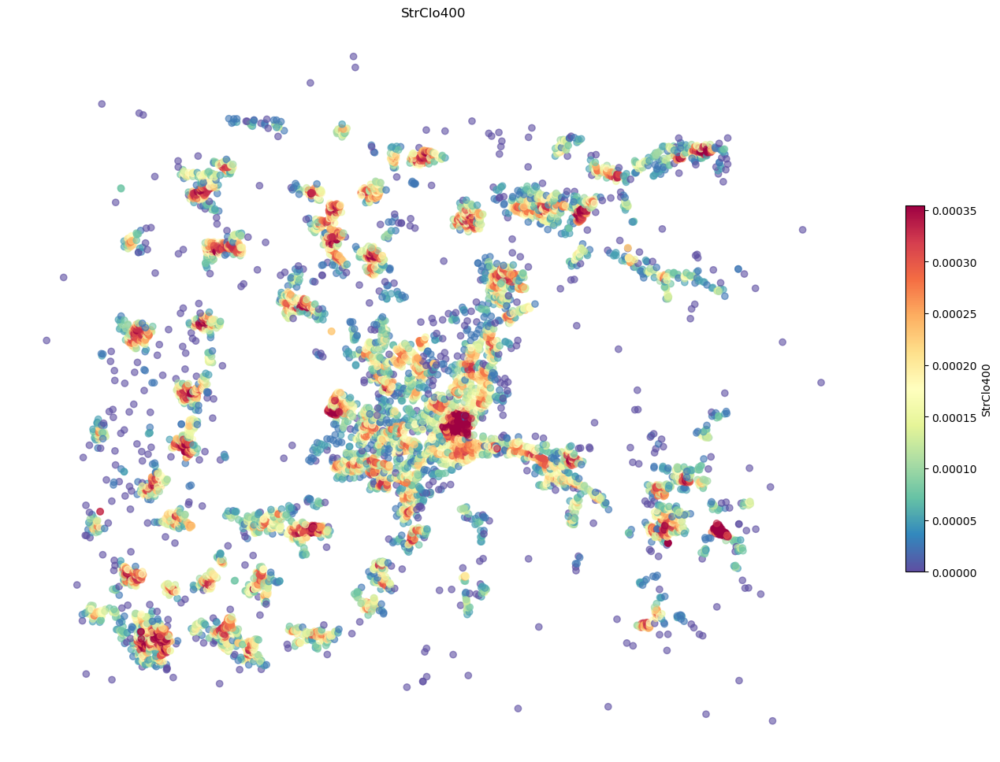

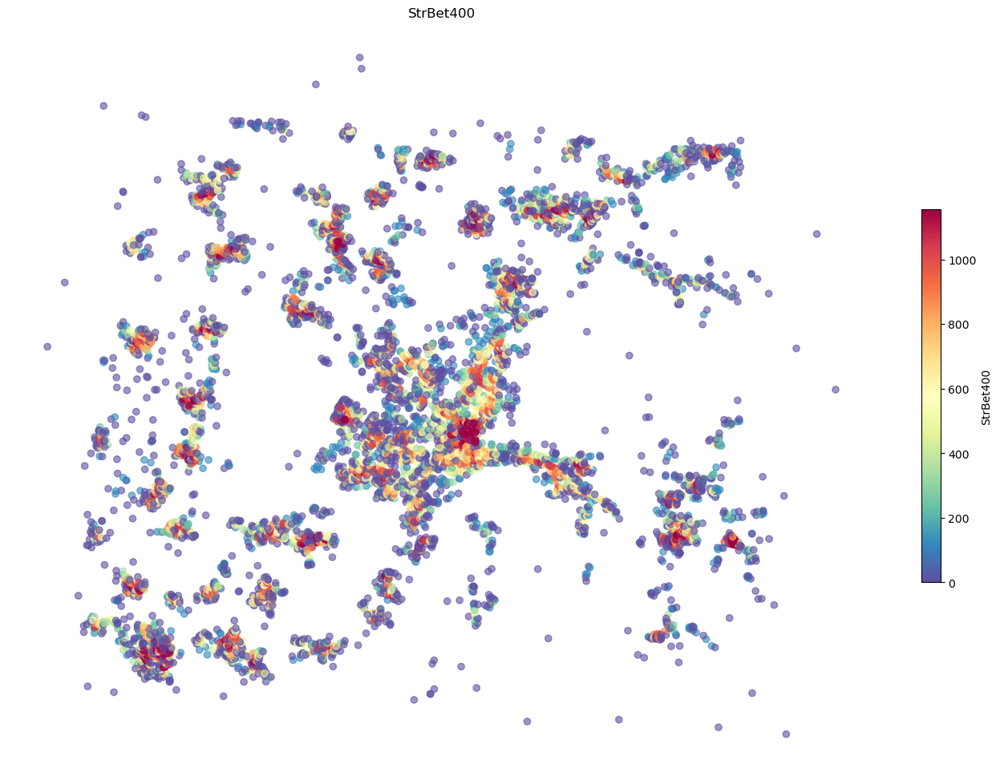

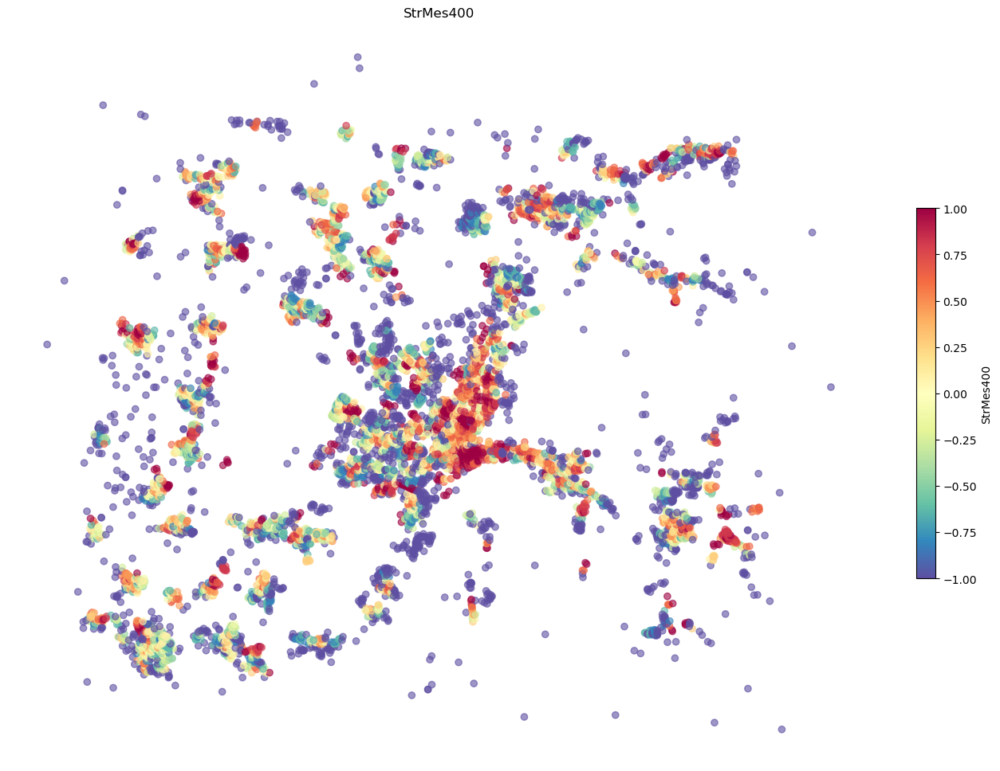

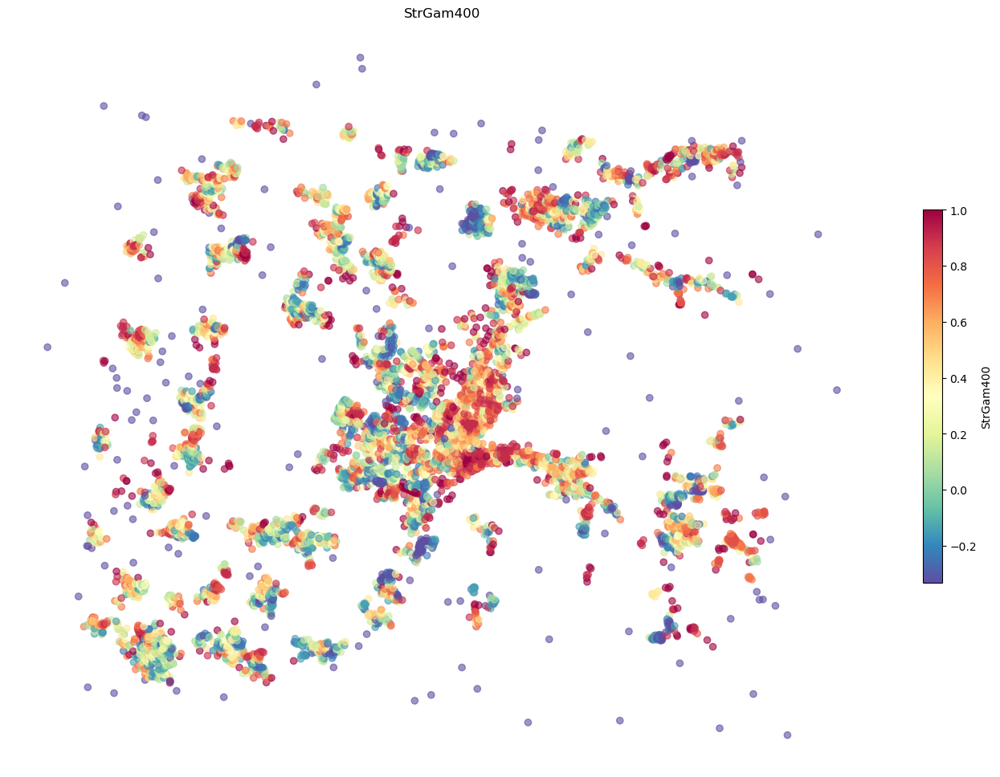

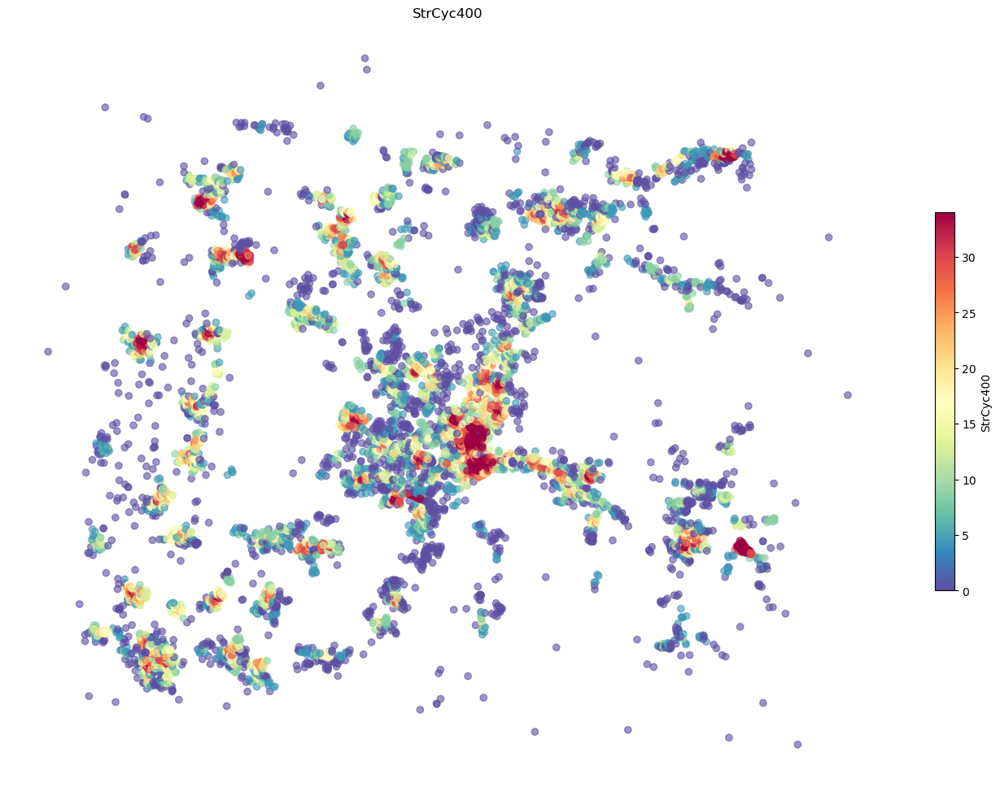

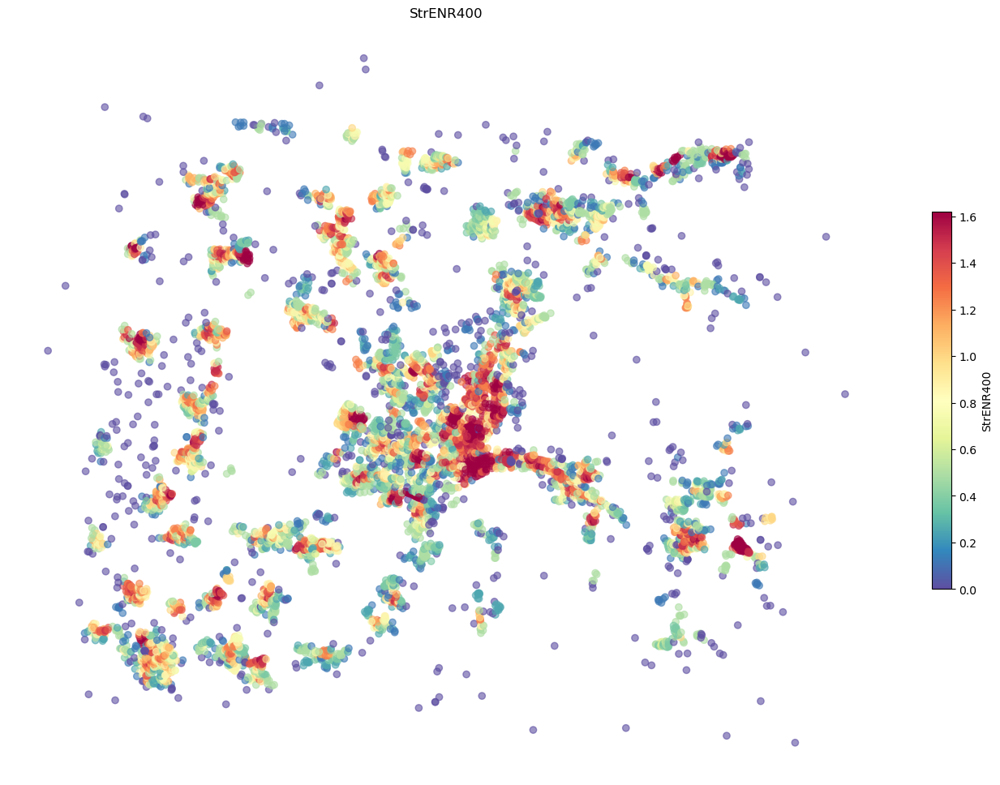

In [15]:
for i in ['StrClo400', 'StrBet400',
       'StrMes400',  'StrGam400',  'StrCyc400',
        'StrENR400']:
    plot_network_chars(i)